In [1]:
# Import the libraries
import OpenBlender
import pandas as pd
import numpy as np
import json
import matplotlib.pyplot as plt
from datetime import datetime
from ast import literal_eval
from sklearn.feature_extraction.text import TfidfVectorizer
%matplotlib inline

### Predefined Functions

In [2]:
pd.set_option("display.max_rows", 1000, "display.max_columns", 1000)
plt.rcParams['figure.figsize'] = [20, 11]

def getReducedDateList(arr_original):
    maximo = int(arr_original.max()) + 2
    minimo = int(arr_original.min())
    n_pedazos = 8
    t = maximo - minimo
    div = int(round(t / n_pedazos))
    
    return pd.Series(list(range(minimo, maximo, div))), [datetime.fromtimestamp(ts - (60 * 60 * 0)).strftime('%d %b %y') for ts in list(range(minimo, maximo, div))]


def graphIndicators(df_1, fecha_ini, fecha_fin, title = '', slope = 0, mm_key = '', df_2 = None):
    fig, ax = plt.subplots()
    fig.figsize = [15, 5]
    #plt.rcParams['figure.figsize'] = [20, 11]

    div_ini = OpenBlender.dateToUnix(fecha_ini , '%d/%m/%y %H:%M', 'America/Winnipeg')
    #div_ini = stringDateToTimestamp(fecha_ini, timezone = 'America/Mexico_City')
    div_fin = OpenBlender.dateToUnix(fecha_fin , '%d/%m/%y %H:%M', 'America/Winnipeg')
    df_1 = df_1[(df_1.timestamp > div_ini) & (df_1.timestamp < div_fin)]

    a1 = ax.plot(df_1.timestamp, df_1.close, label='close price')
    a1 = ax.plot(df_1.timestamp, df_1.open, label='open price')
    
    ax.legend(loc='upper center')
    ax.set_title(title, fontsize=24)
    ax2 = ax.twinx()
    for index, row in df_1[df_1.volume < 12761565].iterrows():
        1 + 1
        #ax2.axvline(row['green'], color = 'green', alpha=0.25)

    if df_2 is not None:
        df_2.timestamp = df_2.timestamp #- (60 * 60 * 24)
        df_2 = df_2[(df_2.timestamp > div_ini) & (df_2.timestamp < div_fin)]
        
        df_2_pos = df_2[df_2.sentiment > 0]
        df_2_neg = df_2[df_2.sentiment < 0]
        ax2.plot(df_2_pos.timestamp, df_2_pos.sentiment * 0.07, 'o', color='green')
        ax2.plot(df_2_neg.timestamp, df_2_neg.sentiment * 0.07, 'o', color='red')
        
        for index, row in df_2_pos.iterrows():
            ax2.axvline(row['timestamp'], color = 'green', alpha=0.25)
            
        for index, row in df_2_neg.iterrows():
            ax2.axvline(row['timestamp'], color = 'red', alpha=0.25)
        
    ax2.plot(df_1[df_1.volume < 12761565].timestamp, df_1[df_1.volume < 12761565].change, 'o', color='green', alpha=0.2 )
    ax2.set_ylabel('Change', fontsize=14)
    ax2.axhline(0, color = 'black', alpha=0.25)
    #plt.xticks(df_1.timestamp, [datetime.utcfromtimestamp(ts).strftime('%Y-%m-%d') for ts in df_1['timestamp']])
    reales, mask = getReducedDateList(df_1.timestamp)
    plt.xticks(reales, mask)
    plt.show()

### The Goal

In [3]:
# You need a token from openblender.io (its free)
token = 'YOUR_TOKEN_HERE'

In [44]:
#  Get the Alphabet (5d4c38739516290b02fe15d7) data aggregated on 1 day intervals for the last 2 years.

action = 'API_getObservationsFromDataset'

interval = 60 * 60 * 24 # One day


parameters = { 
 'token' : token,
    'id_dataset':'5d4c38739516290b02fe15d7',
    'date_filter':{"start_date" : OpenBlender.dateToUnix('2017-01-01 00:00:00', date_format = '%Y-%m-%d %H:%M:%S', timezone = 'EST'),
                   "end_date": OpenBlender.dateToUnix('2020-10-30 00:00:00', date_format = '%Y-%m-%d %H:%M:%S', timezone = 'EST')},
    'aggregate_in_time_interval' : {
              'time_interval_size' : interval, 
              'output' : 'avg', 
              'empty_intervals' : 'impute'
      }
}

# Pull the data into a Pandas Dataframe
df_alphabet = pd.read_json(json.dumps(OpenBlender.call(action, parameters)['sample']), convert_dates=False, convert_axes=False)
df_alphabet.reset_index(drop=True, inplace=True)

Task ID: ''.
Total estimated consumption: 9230.58 processing units.
Task confirmed. Starting download..
33.33 %
66.67 %
100.0 % completed.


In [48]:
# Make lag to have date at 9.30 EST time (we need it to blend data)
hours_lag = 60 * 60 * 9.5
df_alphabet['timestamp'] = [ts - hours_lag for ts in df_alphabet.timestamp]
df_alphabet['date'] = [OpenBlender.unixToDate(ts, timezone = 'EST') for ts in df_alphabet.timestamp]
df_alphabet = df_alphabet.sort_values('timestamp')
df_alphabet.reset_index(drop=True, inplace=True)

# Create our 'change' varaiable
df_alphabet['change'] = np.log(df_alphabet['close']) - np.log(df_alphabet['open'])
df_alphabet

,volume,timestamp,high,count_agg,low,close,open,date,change
0,1959033.0,1.483195e+09,811.435000,0,796.89,808.01,800.620000,31-12-2016 09:30:00,0.009188
1,1959033.0,1.483281e+09,811.435000,0,796.89,808.01,800.620000,01-01-2017 09:30:00,0.009188
2,1959033.0,1.483367e+09,811.435000,0,796.89,808.01,800.620000,02-01-2017 09:30:00,0.009188
3,1959033.0,1.483454e+09,811.435000,1,796.89,808.01,800.620000,03-01-2017 09:30:00,0.009188
4,1515339.0,1.483540e+09,813.430000,1,804.11,807.77,809.890000,04-01-2017 09:30:00,-0.002621
...,...,...,...,...,...,...,...,...,...
1393,1701247.0,1.603636e+09,1631.093333,0,1582.49,1600.52,1615.016667,25-10-2020 09:30:00,-0.009017
1394,1791317.0,1.603723e+09,1629.580000,1,1567.78,1584.29,1615.000000,26-10-2020 09:30:00,-0.019199
1395,1295138.0,1.603809e+09,1602.000000,1,1576.99,1598.88,1588.931900,27-10-2020 09:30:00,0.006241
1396,2258675.0,1.603895e+09,1553.810000,1,1508.48,1510.80,1550.010000,28-10-2020 09:30:00,-0.025622


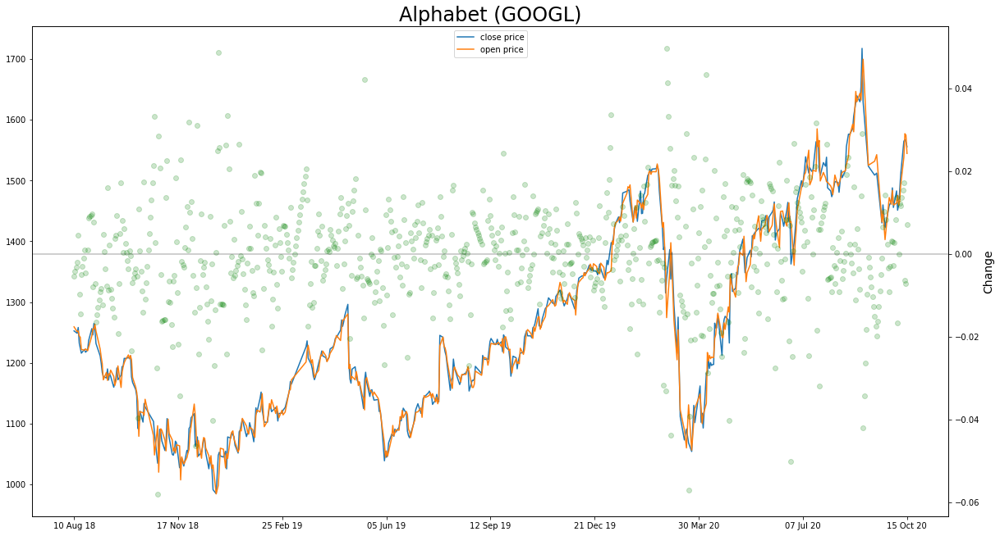

In [49]:
date_ini = '10/08/18 8:30'
date_end = '15/10/20 16:00'

graphIndicators(df_alphabet, date_ini, date_end, title = 'Alphabet (GOOGL)', slope = 0, mm_key = '')

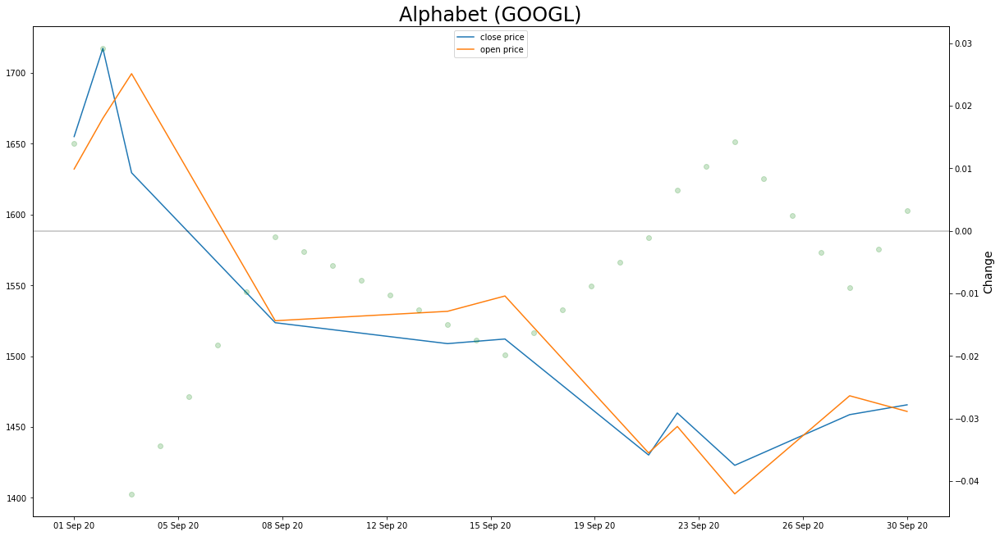

In [50]:
date_ini = '01/09/20 8:30'
date_end = '30/09/20 16:00'

graphIndicators(df_alphabet, date_ini, date_end, title = 'Alphabet (GOOGL)', slope = 0, mm_key = '')

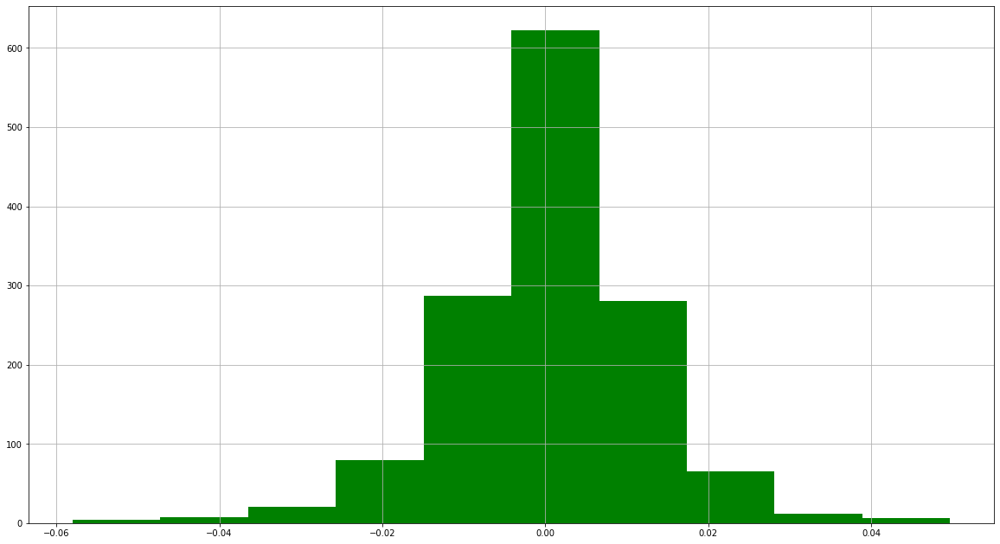

In [13]:
# change histogram
df_alphabet.change.hist(color='green')

In [9]:
df_alphabet.change.mean()

0.0005364529278139045

In [10]:
df_alphabet[df_alphabet.change > 0].change.count()

743

In [11]:
df_alphabet[df_alphabet.change < 0].change.count()

639

In [51]:
df_alphabet['target'] = [1 if ch > 0.003 else 0 for ch in df_alphabet['change']]
df_alphabet

,volume,timestamp,high,count_agg,low,close,open,date,change,target
0,1959033.0,1.483195e+09,811.435000,0,796.89,808.01,800.620000,31-12-2016 09:30:00,0.009188,1
1,1959033.0,1.483281e+09,811.435000,0,796.89,808.01,800.620000,01-01-2017 09:30:00,0.009188,1
2,1959033.0,1.483367e+09,811.435000,0,796.89,808.01,800.620000,02-01-2017 09:30:00,0.009188,1
3,1959033.0,1.483454e+09,811.435000,1,796.89,808.01,800.620000,03-01-2017 09:30:00,0.009188,1
4,1515339.0,1.483540e+09,813.430000,1,804.11,807.77,809.890000,04-01-2017 09:30:00,-0.002621,0
...,...,...,...,...,...,...,...,...,...,...
1393,1701247.0,1.603636e+09,1631.093333,0,1582.49,1600.52,1615.016667,25-10-2020 09:30:00,-0.009017,0
1394,1791317.0,1.603723e+09,1629.580000,1,1567.78,1584.29,1615.000000,26-10-2020 09:30:00,-0.019199,0
1395,1295138.0,1.603809e+09,1602.000000,1,1576.99,1598.88,1588.931900,27-10-2020 09:30:00,0.006241,1
1396,2258675.0,1.603895e+09,1553.810000,1,1508.48,1510.80,1550.010000,28-10-2020 09:30:00,-0.025622,0


In [15]:
df_alphabet[df_alphabet.target == 1].change.count()

551

In [16]:
df_alphabet[df_alphabet.target == 0].change.count()

832

### Sentiment Analysis

In [17]:
# Search for 'wall street' datasets that intersect (time overlap) with ours.

search_term = 'wall street'
  
OpenBlender.searchTimeBlends(token,
                            df_alphabet.timestamp,
                            search_term)


[{'name': 'Wall Street Journal Twitter',
  'url': 'https://www.openblender.io/#/dataset/explore/5e2ef74e9516294390e810a9',
  'id_dataset': '5e2ef74e9516294390e810a9',
  'features': ['associated_tweet',
   'author',
   'author_id',
   'favorite_count',
   'hashtags',
   'id',
   'links',
   'mentions',
   're_tweeter',
   'reply_count',
   'retweet_count',
   'text',
   'time',
   'type'],
  'num_observations': 193101,
  'intersection': '100%',
  'description': 'The latest Twitter threads from Wall Street Journal (@WSJ)'},
 {'name': 'FXStreet News Tweet',
  'url': 'https://www.openblender.io/#/dataset/explore/5eb07763951629211662ba6c',
  'id_dataset': '5eb07763951629211662ba6c',
  'features': ['associated_tweet',
   'author',
   'author_id',
   'favorite_count',
   'hashtags',
   'id',
   'links',
   'mentions',
   're_tweeter',
   'reply_count',
   'retweet_count',
   'text',
   'time',
   'type'],
  'num_observations': 16574,
  'intersection': '11.94%',
  'description': 'The latest Tw

### We'll go with Wall Street Journal
https://www.openblender.io/#/dataset/explore/5e2ef74e9516294390e810a9

In [18]:
# FIlter news that mention 'google'

filter_text = {'name' : 'google', 'match_ngrams': ['google', 'alphabet', 'goog', 
                                                   'tech giant', 'pichai', 'calico', 
                                                   'deepmind']}

# blend source from Wall Street Journal 'text' feature.

blend_source = {
    "id_dataset": "5e2ef74e9516294390e810a9",
    "feature": "text",
    "filter_text" : filter_text
}


# Aggregate news from 1 day after and 1 day before

df_blend = OpenBlender.timeBlend(token = token,
                                anchor_ts = df_alphabet.timestamp,
                                blend_type = 'agg_in_intervals', 
                                direction = 'any',
                                ts_restriction = 'any',
                                interval_output = 'list',
                                interval_size = 60 * 60 * 24 * 1,
                                blend_source = blend_source,
                                missing_values = 'raw')

# Now we have a dataframe with our aggregated 'google' news on time intervals 24 hours before and after each obseravtion.
df_blend

Task ID: ''.
Total estimated consumption: 55320.0 processing units.
Task confirmed. Starting download..
72.0%
100%


,timestamp,WALL_STREE.text_COUNT_pre_post1days:google,WALL_STREE.text_pre_post1days:google
0,1483263000,0,[]
1,1483349400,0,[]
2,1483435800,0,[]
3,1483522200,0,[]
4,1483608600,0,[]
...,...,...,...
1378,1602408600,0,[]
1379,1602495000,0,[]
1380,1602581400,0,[]
1381,1602667800,0,[]


In [17]:
# Let's check the news with 
df_blend['date'] = [OpenBlender.unixToDate(ts, '%d.%m.%Y %H:%M:%S', 'America/Winnipeg') for ts in df_blend.timestamp]
df_blend[df_blend['WALL_STREE.text_COUNT_pre_post1days:google'] > 0]

,timestamp,WALL_STREE.text_COUNT_pre_post1days:google,WALL_STREE.text_pre_post1days:google,date
24,1485302400,1,[google has a messaging app problem],24.01.2017 18:00:00
26,1485475200,1,[google parent alphabet reports jump in earnings],26.01.2017 18:00:00
28,1485648000,2,[google chief sundar pichai criticizes trump o...,28.01.2017 18:00:00
32,1485993600,1,[the cloud public private hybridwhats best for...,01.02.2017 18:00:00
36,1486339200,1,[tech giants could make visa reform work],05.02.2017 18:00:00
37,1486425600,1,"[facebook, google step up efforts to stop fake...",06.02.2017 18:00:00
38,1486512000,1,[how to replace your cars voicecontrol navigat...,07.02.2017 18:00:00
60,1488412800,1,[googles bet on web tv with youtube involves a...,01.03.2017 18:00:00
69,1489190400,1,[alphabets waymo asks court to halt ubers self...,10.03.2017 18:00:00
72,1489449600,1,[how the worlds largest muslim group is workin...,13.03.2017 19:00:00


In [18]:
df_blend['news_list'] = df_blend['WALL_STREE.text_pre_post1days:google'] 
df_blend['news_count'] = df_blend['WALL_STREE.text_COUNT_pre_post1days:google']
df_blend['sentiment'] = 0
df_blend[df_blend['WALL_STREE.text_COUNT_pre_post1days:google'] > 0][['date','news_count','news_list']]

,date,news_count,news_list
24,24.01.2017 18:00:00,1,[google has a messaging app problem]
26,26.01.2017 18:00:00,1,[google parent alphabet reports jump in earnings]
28,28.01.2017 18:00:00,2,[google chief sundar pichai criticizes trump o...
32,01.02.2017 18:00:00,1,[the cloud public private hybridwhats best for...
36,05.02.2017 18:00:00,1,[tech giants could make visa reform work]
37,06.02.2017 18:00:00,1,"[facebook, google step up efforts to stop fake..."
38,07.02.2017 18:00:00,1,[how to replace your cars voicecontrol navigat...
60,01.03.2017 18:00:00,1,[googles bet on web tv with youtube involves a...
69,10.03.2017 18:00:00,1,[alphabets waymo asks court to halt ubers self...
72,13.03.2017 19:00:00,1,[how the worlds largest muslim group is workin...


In [19]:
for index, row in df_blend[df_blend['WALL_STREE.text_COUNT_pre_post1days:google'] > 0][['date','news_count','news_list']].iterrows():
    print(row['date'])
    print(row['news_list'])
    print('---')

24.01.2017 18:00:00
['google has a messaging app problem']
---
26.01.2017 18:00:00
['google parent alphabet reports jump in earnings']
---
28.01.2017 18:00:00
['google chief sundar pichai criticizes trump over immigration order ', 'google ceo sundar pichai criticized trumps immigration order in a staff email']
---
01.02.2017 18:00:00
['the cloud public private hybridwhats best for your business hear from googlecloud svp diane greene at wsjcio ']
---
05.02.2017 18:00:00
['tech giants could make visa reform work']
---
06.02.2017 18:00:00
['facebook, google step up efforts to stop fake news in pivotal year for european politics']
---
07.02.2017 18:00:00
['how to replace your cars voicecontrol navigation and music with google and siri ']
---
01.03.2017 18:00:00
['googles bet on web tv with youtube involves a much smaller wager than atts with directvheard on the street']
---
10.03.2017 18:00:00
['alphabets waymo asks court to halt ubers selfdriving car effort']
---
13.03.2017 19:00:00
['how

In [21]:
sentiments = []
for index, row in df_blend[['date','news_count','news_list']].iterrows():
    if len(row['news_list']) > 0:
        print(row['date'])
        print(row['news_list'])
        print('---')
        #print(sentiments[index])
        sentiments.append(0)
    else:
        sentiments.append(0)

24.01.2017 18:00:00
['google has a messaging app problem']
---
26.01.2017 18:00:00
['google parent alphabet reports jump in earnings']
---
28.01.2017 18:00:00
['google chief sundar pichai criticizes trump over immigration order ', 'google ceo sundar pichai criticized trumps immigration order in a staff email']
---
01.02.2017 18:00:00
['the cloud public private hybridwhats best for your business hear from googlecloud svp diane greene at wsjcio ']
---
05.02.2017 18:00:00
['tech giants could make visa reform work']
---
06.02.2017 18:00:00
['facebook, google step up efforts to stop fake news in pivotal year for european politics']
---
07.02.2017 18:00:00
['how to replace your cars voicecontrol navigation and music with google and siri ']
---
01.03.2017 18:00:00
['googles bet on web tv with youtube involves a much smaller wager than atts with directvheard on the street']
---
10.03.2017 18:00:00
['alphabets waymo asks court to halt ubers selfdriving car effort']
---
13.03.2017 19:00:00
['how

08.09.2020 19:00:00
['ex-google ceo eric schmidt and his wife, wendy schmidt, purchased an historic estate in montecito, calif_, for 30_8 million_the home once housed a think tank that brought together the likes of john f_ kennedy, martin luther king jr_ and henry kissinger_']
---
30.09.2020 19:00:00
['google announced a new generation of mobile and smart-home products including two 5g-capable pixel smartphones, the rebranded smart speaker nest audio and achromecast streaming-media player with a remote control']
---
01.10.2020 19:00:00
['facebooks mark zuckerbeg twitters jack dorsey and googles sundar pichai have been called to testify on their companies legal immunity in managing content on their sitesin the midst of a national election']
---
02.10.2020 19:00:00
['amazon on thursday said more than 19,000 of its workers have tested positive for the novel coronavirus, the first time the tech giant has revealed such detailed data_ the company said the number of positive cases is below wh

In [22]:
df_blend.to_csv('google_data/unlabled_news.csv')

### I manually labeled each day of news on Excel

In [19]:
df_labeled_news = pd.read_csv('google_data/labeled_news.csv')
df_labeled_news[df_labeled_news.news_count > 0][['date','news_list', 'sentiment']]

,date,news_list,sentiment
24,24.01.2017 18:00:00,['google has a messaging app problem'],-1.0
26,26.01.2017 18:00:00,['google parent alphabet reports jump in earni...,1.0
28,28.01.2017 18:00:00,['google chief sundar pichai criticizes trump ...,0.0
32,01.02.2017 18:00:00,['the cloud public private hybridwhats best fo...,0.0
36,05.02.2017 18:00:00,['tech giants could make visa reform work'],1.0
37,06.02.2017 18:00:00,"['facebook, google step up efforts to stop fak...",1.0
38,07.02.2017 18:00:00,['how to replace your cars voicecontrol naviga...,0.0
60,01.03.2017 18:00:00,['googles bet on web tv with youtube involves ...,0.0
69,10.03.2017 18:00:00,['alphabets waymo asks court to halt ubers sel...,1.0
72,13.03.2017 19:00:00,['how the worlds largest muslim group is worki...,1.0


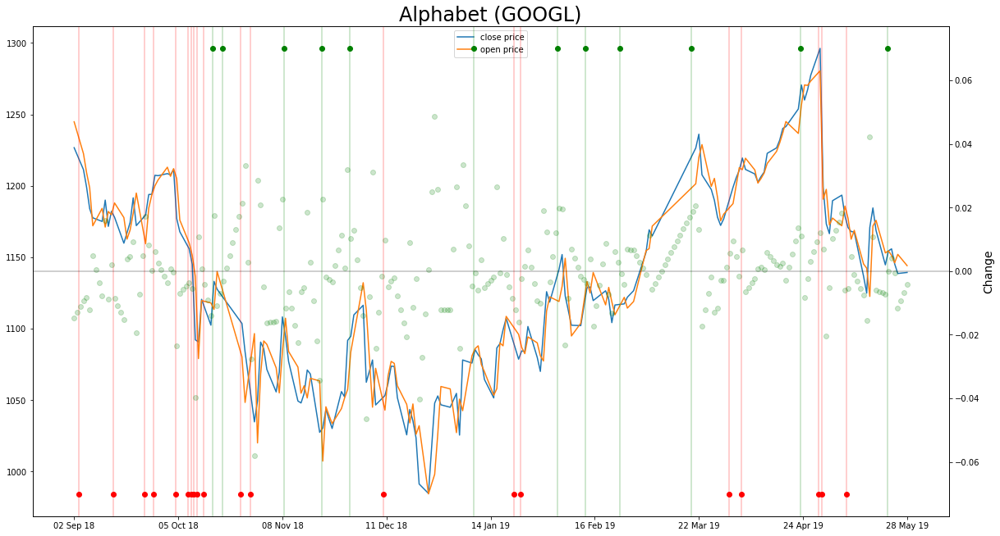

In [20]:
date_ini = '01/09/20 8:30'
date_end = '30/09/20 16:00'

date_ini = '10/08/18 8:30'
date_end = '15/10/20 16:00'

date_ini = '01/09/18 8:30'
date_end = '28/05/19 16:00'

graphIndicators(df_alphabet, date_ini, date_end, title = 'Alphabet (GOOGL)', slope = 0, mm_key = '', df_2 = df_labeled_news)

In [21]:
# Lets separate every text with the sentiment

labeled_news = []

for index, row in df_labeled_news[df_labeled_news.news_count > 0][['date','news_list', 'sentiment']].iterrows():
    for text in literal_eval(row['news_list']):
        labeled_news.append({'text' : text, 'sentiment' : row['sentiment']})

labeled_news_df = pd.DataFrame(labeled_news)

labeled_news_df

,text,sentiment
0,google has a messaging app problem,-1.0
1,google parent alphabet reports jump in earnings,1.0
2,google chief sundar pichai criticizes trump ov...,0.0
3,google ceo sundar pichai criticized trumps imm...,0.0
4,the cloud public private hybridwhats best for ...,0.0
5,tech giants could make visa reform work,1.0
6,"facebook, google step up efforts to stop fake ...",1.0
7,how to replace your cars voicecontrol navigati...,0.0
8,googles bet on web tv with youtube involves a ...,0.0
9,alphabets waymo asks court to halt ubers selfd...,1.0


In [22]:
# Let's vectorize the data and add the n-grams to our dataframe.

corpus = list(labeled_news_df.text)
vectorizer = TfidfVectorizer(ngram_range = (1,2), stop_words = 'english', min_df = 2)
X = vectorizer.fit_transform(corpus)
df_tokenized_news = pd.DataFrame.sparse.from_spmatrix(X, columns = vectorizer.get_feature_names())
df_sentiment = pd.concat([labeled_news_df, df_tokenized_news], axis = 1)
print(df_sentiment.shape)
df_sentiment

(522, 1552)


text  sentiment        10  \
0                   google has a messaging app problem       -1.0  0.000000   
1      google parent alphabet reports jump in earnings        1.0  0.000000   
2    google chief sundar pichai criticizes trump ov...        0.0  0.000000   
3    google ceo sundar pichai criticized trumps imm...        0.0  0.000000   
4    the cloud public private hybridwhats best for ...        0.0  0.000000   
5              tech giants could make visa reform work        1.0  0.000000   
6    facebook, google step up efforts to stop fake ...        1.0  0.000000   
7    how to replace your cars voicecontrol navigati...        0.0  0.000000   
8    googles bet on web tv with youtube involves a ...        0.0  0.000000   
9    alphabets waymo asks court to halt ubers selfd...        1.0  0.000000   
10   how the worlds largest muslim group is working...        1.0  0.000000   
11   googles family link software offers new ways p...        1.0  0.000000   
12   cmo today newsletter guardian pulls google ads...        0.0  0.000000   
13   googles family link software offers new ways p...        1.0  0.000000   
14   google is acting after a backlash over ads tha...        0.0  0.000000   
15   big advertisers will likely return, but growth...       -1.0  0.000000   
16   googles youtube has continued showing brands a...        0.0  0.000000   
17   google unveiled measures meant to help markete...        0.0  0.000000   
18   google pays women less than men, department of...        0.0  0.000000   
19   google pays female workers less than male coun...        0.0  0.000000   
20   google is planning to introduce an ad-blocking...        0.0  0.000000   
21   online publishers are eyeing the impact on the...        0.0  0.000000   
22   alphabets waymo claims uber hid selfdriving te...        1.0  0.000000   
23   google is changing its powerful search algorit...        1.0  0.000000   
24   google parent alphabets first-quarter profit a...        1.0  0.000000   
25   amazon and alphabet race to join the 1000 club...        1.0  0.000000   
26   google doubles down on its bet on artificial i...        1.0  0.000000   
27   a star google engineers side businesses trigge...        0.0  0.000000   
28   worlds richest money managers are duking it ou...        1.0  0.000000   
29   when a hedge fund battles google to hire the s...        0.0  0.000000   
30   uber fired an executive key to a fight with go...        0.0  0.000000   
31   want to get ahead subscribe to our living ambi...        0.0  0.000000   
32   google describes its ad blocker as a filter fo...        0.0  0.000000   
33   amazon and alphabet has helped push the techno...        1.0  0.000000   
34   meet @300 entertainment, the google-backed ind...        1.0  0.000000   
35   correction whos behind migos young thug and fe...        1.0  0.000000   
36   alphabet is retiring its self-driving firefly ...       -1.0  0.000000   
37   opinion: uber and google face cultural challen...        0.0  0.000000   
38   amazons bid for whole foods shows how a few te...        0.0  0.000000   
39   google is facing government accusations that i...       -1.0  0.000000   
40   google to stop reading users emails to target ads       -1.0  0.000000   
41   googles rivals cheered the eus penalty but wil...       -1.0  0.000000   
42   facebook, google and civil-rights groups say a...        0.0  0.000000   
43   finance, insurance firms move to nyc areas pop...        1.0  0.000000   
44   opinion: antitrust laws are preventing news co...       -1.0  0.000000   
45   media outlets want to band together to tackle ...       -1.0  0.000000   
46   media outlets want to band together to take do...       -1.0  0.000000   
47   google pays professors who write academic pape...        1.0  0.000000   
48   some professors who accept google stipends all...        1.0  0.000000   
49   googles 13 billion backtax bill is tossed out ...        1.0  0.000000   
50   this google scie

In [27]:
corrs = df_sentiment.corr()['sentiment'].sort_values()

In [28]:
corrs[:20]

antitrust               -0.179742
facebook                -0.135025
congress                -0.132992
faces                   -0.131884
political               -0.129570
sought                  -0.119576
likely                  -0.119293
alphabet reported       -0.119076
parent company          -0.118531
like facebook           -0.117530
ceos                    -0.111074
eu                      -0.110694
law                     -0.107062
hearing                 -0.106325
advertising             -0.103443
congressional hearing   -0.103391
congressional           -0.103391
quarter earnings        -0.103372
ceos amazon             -0.103332
affected                -0.103279
Name: sentiment, dtype: float64

In [29]:
corrs[-20:]

alphabets waymo     0.111567
drones              0.112299
300                 0.113114
europe              0.113325
alphabet posted     0.113600
push                0.113657
millions patient    0.113748
patient             0.113748
computer            0.114676
offers              0.115627
strong              0.116078
alphabets           0.119995
worlds              0.124476
service             0.125878
google cloud        0.128677
records             0.135280
court               0.135903
cloud               0.141266
millions            0.144119
sentiment           1.000000
Name: sentiment, dtype: float64

### ML to predict sentiment with n-grams

In [52]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score
from sklearn import metrics

In [53]:
# There are 2 data leakage situations with the following code:
# 1) We are tokenizing with all the data (new tokens would not be visible on the whole timeline)
# 2) We are randomly selecting train and test sets (we should do it chronologically)
# The reason I did this is because it helps for interpretability and it doesn't change the end results significanlty.

In [54]:
import traceback
def balanceDf(df, target):
    try:
        sub_df = df[df[target] == 1]
        minoria = sub_df.shape[0]
        mayoria = df.shape[0] - minoria
        if minoria < mayoria:
            print('Balanced 1 cases, added: ' + str(mayoria - minoria))
            df_sub = sub_df.sample(mayoria - minoria, replace = True)
            df_resp = pd.concat([df, df_sub], ignore_index=True)
        else:
            sub_df = df[df[target] == 0]
            minoria = sub_df.shape[0]
            mayoria = df.shape[0] - minoria
            if minoria < mayoria:
                print('Balanced 0 cases, added: ' + str(mayoria - minoria))
                df_sub = sub_df.sample(mayoria - minoria, replace = True)
                df_resp = pd.concat([df, df_sub], ignore_index=True)
            else:
                df_resp = df
    except:
        print(traceback.format_exc())
        return df
    return df_resp

In [26]:
target = 'sentiment'

# First, for POSITIVES

# Drop non numerics
df = df_sentiment.dropna(axis=1).select_dtypes(['number'])  
df[target] = [1 if val > 0 else 0 for val in df[target]]

df_train, df_test = train_test_split(df, test_size = 0.3)

#df_train = balanceDf(df_train, target)#.dropna(axis=1).select_dtypes(['number'])

# Create train/test sets
X_train = df_train.loc[:, df_train.columns != target].values
y_train = df_train.loc[:,[target]].values

X_test = df_test.loc[:, df_test.columns != target].values
y_test = df_test.loc[:,[target]].values

print('Train Shape:')
print(X_train.shape)
print(y_train.shape) 
print('Test Shape:')
print(X_test.shape)
print(y_test.shape) 

#Random forest model specification
model = RandomForestRegressor(n_estimators = 2000, criterion='mse')       
# Train on data
model.fit(X_train, y_train.ravel())

Train Shape:
(365, 1550)
(365, 1)
Test Shape:
(157, 1550)
(157, 1)


RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=2000, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False)

In [27]:
y_pred_random = model.predict(X_test)
preds = [1 if val > 0.5 else 0 for val in y_pred_random]
y_test_d = y_test.ravel()

print("AUC score:")
print(roc_auc_score(y_test_d, y_pred_random))
print('---')
# Let's binarize and look at the confusion matrix
print('Confusion Matrix:')
print(metrics.confusion_matrix(y_test_d, preds))
print('---')
# Lets look at the precision score
print('Precision Score:')
print(precision_score(y_test_d, preds))
print('---')

AUC score:
0.7183165949306551
---
Confusion Matrix:
[[121   2]
 [ 25   9]]
---
Precision Score:
0.8181818181818182
---


In [28]:
# Then, for NEGATIVES

# Drop non numerics
df = df_sentiment.dropna(axis=1).select_dtypes(['number'])  
df[target] = [1 if val < 0 else 0 for val in df[target]]

df_train, df_test = train_test_split(df, test_size=0.3)

#df_train = balanceDf(df_train, target)#.dropna(axis=1).select_dtypes(['number'])

# Create train/test sets
X_train = df_train.loc[:, df_train.columns != target].values
y_train = df_train.loc[:,[target]].values

X_test = df_test.loc[:, df_test.columns != target].values
y_test = df_test.loc[:,[target]].values

print('Train Shape:')
print(X_train.shape)
print(y_train.shape) 
print('Test Shape:')
print(X_test.shape)
print(y_test.shape) 

#Random forest model specification
model = RandomForestRegressor(n_estimators = 2000, criterion='mse')       
# Train on data
model.fit(X_train, y_train.ravel())

Train Shape:
(365, 1550)
(365, 1)
Test Shape:
(157, 1550)
(157, 1)


RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=2000, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False)

In [29]:
y_pred_random = model.predict(X_test)
preds = [1 if val > 0.5 else 0 for val in y_pred_random]
y_test_d = y_test.ravel()

print("AUC score:")
print(roc_auc_score(y_test_d, y_pred_random))
print('---')
# Let's binarize and look at the confusion matrix
print('Confusion Matrix:')
print(metrics.confusion_matrix(y_test_d, preds))
print('---')
# Lets look at the precision score
print('Precision Score:')
print(precision_score(y_test_d, preds))
print('---')


AUC score:
0.7116471099521947
---
Confusion Matrix:
[[111   7]
 [ 29  10]]
---
Precision Score:
0.5882352941176471
---


## Predict Price With News

In [55]:
# Let's go back to our alphabet price dataframe
df_alphabet

,volume,timestamp,high,count_agg,low,close,open,date,change,target
0,1959033.0,1.483195e+09,811.435000,0,796.89,808.01,800.620000,31-12-2016 09:30:00,0.009188,1
1,1959033.0,1.483281e+09,811.435000,0,796.89,808.01,800.620000,01-01-2017 09:30:00,0.009188,1
2,1959033.0,1.483367e+09,811.435000,0,796.89,808.01,800.620000,02-01-2017 09:30:00,0.009188,1
3,1959033.0,1.483454e+09,811.435000,1,796.89,808.01,800.620000,03-01-2017 09:30:00,0.009188,1
4,1515339.0,1.483540e+09,813.430000,1,804.11,807.77,809.890000,04-01-2017 09:30:00,-0.002621,0
...,...,...,...,...,...,...,...,...,...,...
1393,1701247.0,1.603636e+09,1631.093333,0,1582.49,1600.52,1615.016667,25-10-2020 09:30:00,-0.009017,0
1394,1791317.0,1.603723e+09,1629.580000,1,1567.78,1584.29,1615.000000,26-10-2020 09:30:00,-0.019199,0
1395,1295138.0,1.603809e+09,1602.000000,1,1576.99,1598.88,1588.931900,27-10-2020 09:30:00,0.006241,1
1396,2258675.0,1.603895e+09,1553.810000,1,1508.48,1510.80,1550.010000,28-10-2020 09:30:00,-0.025622,0


In [58]:
# Now let's blend the 'google' news

# FIlter news that mention 'google'

filter_text = {'name' : 'google', 'match_ngrams': ['google', 'alphabet', 'goog', 
                                                   'tech giant', 'pichai', 'calico', 
                                                   'deepmind']}

# blend source from Wall Street Journal 'text' feature.

blend_source = {
    "id_dataset": "5e2ef74e9516294390e810a9",
    "feature": "text",
    "filter_text" : filter_text
}


# Aggregate news from 17.5 hours before the opening time (so we get all the after hours)

df_blend = OpenBlender.timeBlend(token = token,
                                anchor_ts = df_alphabet.timestamp,
                                blend_type = 'agg_in_intervals', 
                                direction = 'time_prior',
                                ts_restriction = 'any',
                                interval_output = 'list',
                                interval_size = 60 * 60 * 17.5,
                                blend_source = blend_source,
                                missing_values = 'raw')

df_anchor = pd.concat([df_alphabet, df_blend.loc[:, df_blend.columns != 'timestamp']], axis = 1)
df_anchor

Task ID: ''.
Total estimated consumption: 55920.0 processing units.
Task confirmed. Starting download..
72.0%
100%


,volume,timestamp,high,count_agg,low,close,open,date,change,target,WALL_STREE.text_COUNT_last18hr:google,WALL_STREE.text_last18hr:google
0,1959033.0,1.483195e+09,811.435000,0,796.89,808.01,800.620000,31-12-2016 09:30:00,0.009188,1,0,[]
1,1959033.0,1.483281e+09,811.435000,0,796.89,808.01,800.620000,01-01-2017 09:30:00,0.009188,1,0,[]
2,1959033.0,1.483367e+09,811.435000,0,796.89,808.01,800.620000,02-01-2017 09:30:00,0.009188,1,0,[]
3,1959033.0,1.483454e+09,811.435000,1,796.89,808.01,800.620000,03-01-2017 09:30:00,0.009188,1,0,[]
4,1515339.0,1.483540e+09,813.430000,1,804.11,807.77,809.890000,04-01-2017 09:30:00,-0.002621,0,0,[]
...,...,...,...,...,...,...,...,...,...,...,...,...
1393,1701247.0,1.603636e+09,1631.093333,0,1582.49,1600.52,1615.016667,25-10-2020 09:30:00,-0.009017,0,0,[]
1394,1791317.0,1.603723e+09,1629.580000,1,1567.78,1584.29,1615.000000,26-10-2020 09:30:00,-0.019199,0,0,[]
1395,1295138.0,1.603809e+09,1602.000000,1,1576.99,1598.88,1588.931900,27-10-2020 09:30:00,0.006241,1,0,[]
1396,2258675.0,1.603895e+09,1553.810000,1,1508.48,1510.80,1550.010000,28-10-2020 09:30:00,-0.025622,0,0,[]


In [59]:
df_anchor[df_anchor['WALL_STREE.text_COUNT_last18hr:google'] > 0]

,volume,timestamp,high,count_agg,low,close,open,date,change,target,WALL_STREE.text_COUNT_last18hr:google,WALL_STREE.text_last18hr:google
25,1.662148e+06,1.485355e+09,858.793600,1,849.740000,858.450000,853.550000,25-01-2017 09:30:00,0.005724,1,1,[google has a messaging app problem]
27,3.752497e+06,1.485527e+09,867.000000,1,841.900000,845.030000,859.000000,27-01-2017 09:30:00,-0.016397,0,1,[google parent alphabet reports jump in earnings]
28,3.673976e+06,1.485614e+09,857.076667,0,834.943333,837.963333,851.686667,28-01-2017 09:30:00,-0.016244,0,1,[google chief sundar pichai criticizes trump o...
70,1.279925e+06,1.489243e+09,865.196667,0,858.680000,862.466667,862.076667,11-03-2017 09:30:00,0.000452,0,1,[alphabets waymo asks court to halt ubers self...
73,1.061692e+06,1.489502e+09,867.580000,1,860.130000,865.910000,863.750000,14-03-2017 09:30:00,0.002498,0,1,[how the worlds largest muslim group is workin...
75,1.104452e+06,1.489675e+09,872.710000,1,867.520000,870.000000,870.530000,16-03-2017 09:30:00,-0.000609,0,1,[googles family link software offers new ways ...
79,1.542199e+06,1.490020e+09,870.340000,1,864.670000,867.910000,869.480000,20-03-2017 09:30:00,-0.001807,0,1,[googles family link software offers new ways ...
81,1.366749e+06,1.490193e+09,855.350000,1,847.000000,849.800000,849.480000,22-03-2017 09:30:00,0.000377,0,1,[google is acting after a backlash over ads th...
84,2.048858e+06,1.490452e+09,843.126667,0,827.500000,836.263333,837.363333,25-03-2017 09:30:00,-0.001315,0,1,[googles youtube has continued showing brands ...
94,1.348494e+06,1.491316e+09,853.000000,1,847.510000,852.570000,848.000000,04-04-2017 09:30:00,0.005375,1,1,[google unveiled measures meant to help market...


In [60]:
# Lets separate every text with the sentiment

sentiment_est = []

for index, row in df_anchor[['WALL_STREE.text_COUNT_last18hr:google','WALL_STREE.text_last18hr:google']].iterrows():
    if row['WALL_STREE.text_COUNT_last18hr:google'] > 0:
        corpus = row['WALL_STREE.text_last18hr:google']
        if len(corpus) > 0 :
            X = vectorizer.transform(corpus)
            df_tokenized_news = pd.DataFrame.sparse.from_spmatrix(X, columns = vectorizer.get_feature_names())
            df_test = df_tokenized_news.dropna(axis=1).select_dtypes(['number'])
            X_test = df_test.loc[:, df_test.columns != target].values
            sentiment_est.append(model.predict(X_test).mean())
        else:
            sentiment_est.append(0)
    else:
        sentiment_est.append(0)
    print(index)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [61]:
df_anchor['sentiment'] = sentiment_est
df_anchor[df_anchor['WALL_STREE.text_COUNT_last18hr:google'] > 0]

,volume,timestamp,high,count_agg,low,close,open,date,change,target,WALL_STREE.text_COUNT_last18hr:google,WALL_STREE.text_last18hr:google,sentiment
25,1.662148e+06,1.485355e+09,858.793600,1,849.740000,858.450000,853.550000,25-01-2017 09:30:00,0.005724,1,1,[google has a messaging app problem],0.833000
27,3.752497e+06,1.485527e+09,867.000000,1,841.900000,845.030000,859.000000,27-01-2017 09:30:00,-0.016397,0,1,[google parent alphabet reports jump in earnings],0.178000
28,3.673976e+06,1.485614e+09,857.076667,0,834.943333,837.963333,851.686667,28-01-2017 09:30:00,-0.016244,0,1,[google chief sundar pichai criticizes trump o...,0.058000
70,1.279925e+06,1.489243e+09,865.196667,0,858.680000,862.466667,862.076667,11-03-2017 09:30:00,0.000452,0,1,[alphabets waymo asks court to halt ubers self...,0.000000
73,1.061692e+06,1.489502e+09,867.580000,1,860.130000,865.910000,863.750000,14-03-2017 09:30:00,0.002498,0,1,[how the worlds largest muslim group is workin...,0.017000
75,1.104452e+06,1.489675e+09,872.710000,1,867.520000,870.000000,870.530000,16-03-2017 09:30:00,-0.000609,0,1,[googles family link software offers new ways ...,0.012500
79,1.542199e+06,1.490020e+09,870.340000,1,864.670000,867.910000,869.480000,20-03-2017 09:30:00,-0.001807,0,1,[googles family link software offers new ways ...,0.012500
81,1.366749e+06,1.490193e+09,855.350000,1,847.000000,849.800000,849.480000,22-03-2017 09:30:00,0.000377,0,1,[google is acting after a backlash over ads th...,0.056000
84,2.048858e+06,1.490452e+09,843.126667,0,827.500000,836.263333,837.363333,25-03-2017 09:30:00,-0.001315,0,1,[googles youtube has continued showing brands ...,0.086000
94,1.348494e+06,1.491316e+09,853.000000,1,847.510000,852.570000,848.000000,04-04-2017 09:30:00,0.005375,1,1,[google unveiled measures meant to help market...,0.056000


In [66]:
target = 'target'

# Drop non numerics
df = df_anchor.dropna(axis=1).select_dtypes(['number'])  
df[target] = [1 if val > 0.003 else 0 for val in df.change]

# We align the target of 'today' with the info from 'yerterday' to train for the future.
df[target] = df[target].shift(-1)
df = df[:-1].reset_index(drop=True)

# We divide chronologically this time
div = int(round(df.shape[0] * 0.78))
df_train = df[:div]
df_test = df[div:]

#df_train = balanceDf(df_train, target)#.dropna(axis=1).select_dtypes(['number'])

# Create train/test sets
X_train = df_train.loc[:, df_train.columns != target].values
y_train = df_train.loc[:,[target]].values

X_test = df_test.loc[:, df_test.columns != target].values
y_test = df_test.loc[:,[target]].values

print('Train Shape:')
print(X_train.shape)
print(y_train.shape) 
print('Test Shape:')
print(X_test.shape)
print(y_test.shape) 

#Random forest model specification
model_price = RandomForestRegressor(n_estimators = 4000, criterion='mse')       
# Train on data
model_price.fit(X_train, y_train.ravel())

Train Shape:
(1090, 10)
(1090, 1)
Test Shape:
(307, 10)
(307, 1)


RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=4000, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False)

In [67]:
y_pred_random = model_price.predict(X_test)

In [68]:
preds = [1 if val > 0.5 else 0 for val in y_pred_random]
y_test_d = y_test.ravel()

print("AUC score:")
print(roc_auc_score(y_test_d, y_pred_random))
print('---')
# Let's binarize and look at the confusion matrix
print('Confusion Matrix:')
print(metrics.confusion_matrix(y_test_d, preds))
print('---')
# Lets look at the precision score
print('Precision Score:')
print(precision_score(y_test_d, preds))
print('---')

AUC score:
0.7408026755852843
---
Confusion Matrix:
[[146  23]
 [ 80  58]]
---
Precision Score:
0.7160493827160493
---
